In [36]:
import numpy as np
import matplotlib.pyplot as plt
import IPython as ip
import scipy.io.wavfile as wav

In [34]:
# Original Audio
ip.display.Audio("test.wav")

In [3]:
# 2 Columns (Left, Right speakers)
sample_rate, data = wav.read("test.wav")
print(sample_rate)
print(data)

48000
[[   -2    -1]
 [   -1    -1]
 [   -1    -1]
 ...
 [ -101 -2761]
 [ -162 -2565]
 [ -424 -2535]]


[  -2   -1   -1 ... -101 -162 -424]


Text(0.5, 0, 'Seconds')

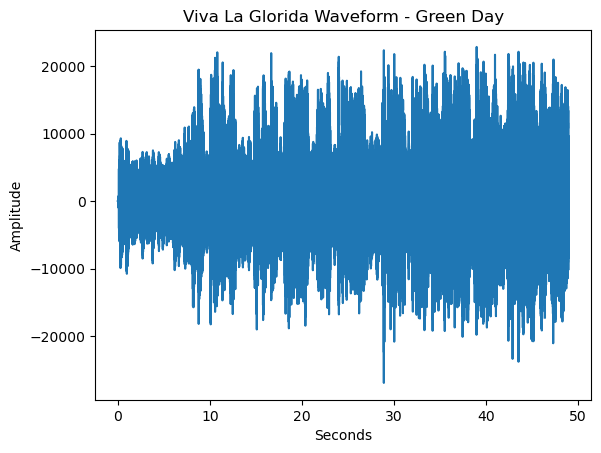

In [15]:
# Take Left
x_n = data[:, 0]
print(x_n)
plt.figure(1)
x = np.linspace(0, len(x_n), num = len(x_n)) 
plt.plot(x/rate, x_n)
plt.title("Viva La Gloria Waveform - Green Day")
plt.ylabel("Amplitude")
plt.xlabel("Seconds")

In [5]:
# See! It's the same (basically)
ip.display.Audio(x_n, rate=rate)

Text(0, 0.5, 'Amplitude')

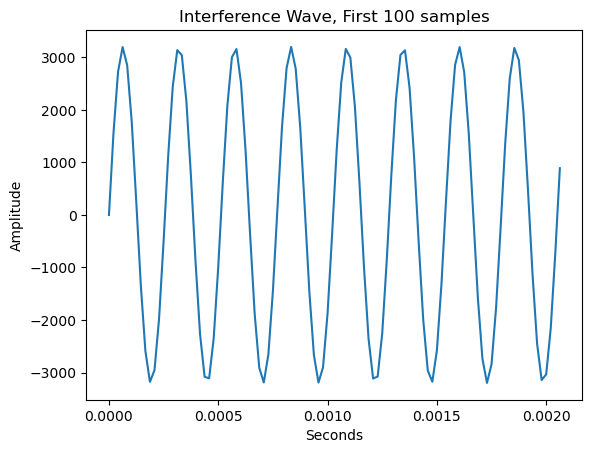

In [23]:
# Now to add in some noise!
A = 3200
freq = 3900
secs = 49
Noise = A * np.sin(np.linspace(0, 2 * np.pi * freq * secs, 2351664))
plt.figure(2)
plt.plot(x[0:100]/rate, Noise[0:100])
plt.title("Interference Wave, First 100 samples")
plt.xlabel("Seconds")
plt.ylabel("Amplitude")

In [7]:
# What our interference wave sounds like
ip.display.Audio(Noise, rate=rate)

In [27]:
# Let's add them together...
Interfered_Wave = x_n + Noise
ip.display.Audio(Interfered_Wave, rate=rate)

Text(0, 0.5, 'Amplitude')

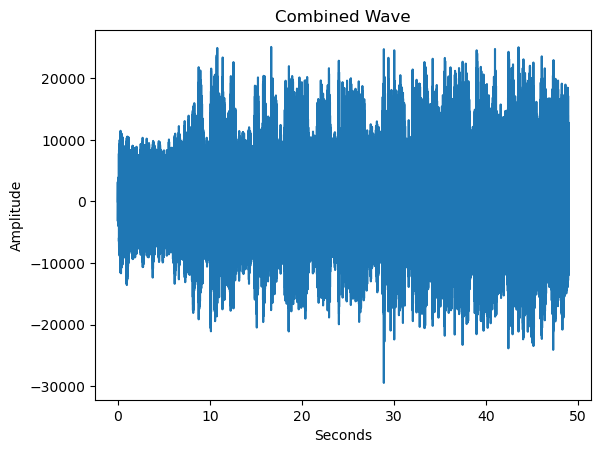

In [28]:
plt.figure(3)
plt.plot(x/rate, Interfered_Wave)
plt.title("Combined Wave")
plt.xlabel("Seconds")
plt.ylabel("Amplitude")

In [9]:
# Now what if we wanted to remove this sound, but don't know what the frequency of the noise is? Or had many different frequencies that came from a spectrum that were causing interference?
# We would need to 1) Identify them 2) Find a way to remove them (can't just subtract if it's a range of frequencies).

Noise is at approx 3900 Hz


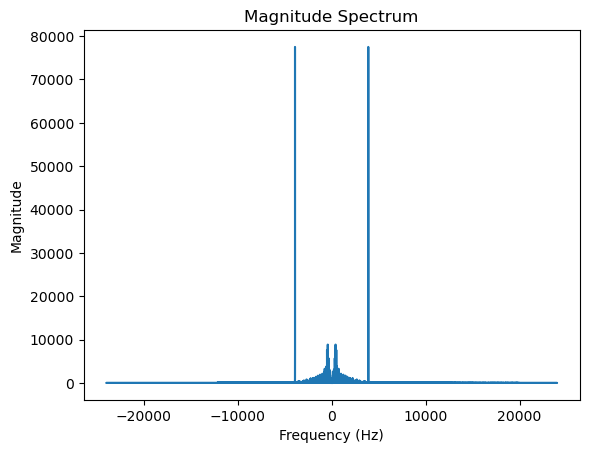

In [55]:
#Step 1: Identification. Here we take the Fast Fourier Transform (essentially an optimized way to calculate the Fourier Transform when data is discrete elements like computers work)
# This specific type of transform will not work for all data, and is only being used here because the frequency present is very far away from the other frequencies in the song.
frequencies_present = np.fft.fft(Interfered_Wave)
x_axis = np.fft.fftfreq(len(Interfered_Wave), d = 1/rate)
plt.figure(4)
plt.plot(x_axis, np.abs(frequencies_present)/rate)
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")
plt.title("Magnitude Spectrum")

# Analyzing the Magnitude Spectrum...
i = np.argmax(frequencies_present[x_axis > 0])
print("Noise is at approx", int(x_axis[i]), "Hz")
# Rounding to the nearest integer gives the frequency of the added waveform

Text(0, 0.5, 'Magnitude')

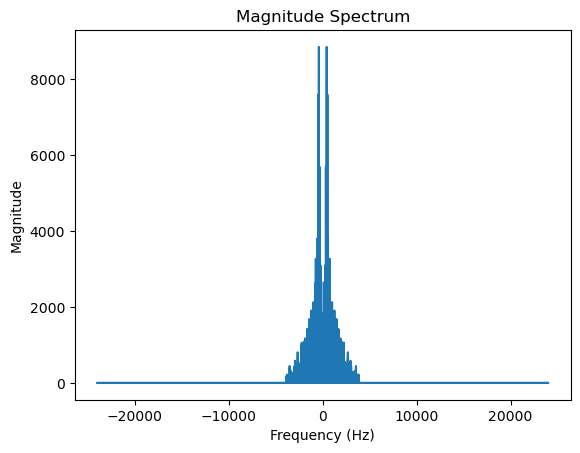

In [54]:
# Step 2: Removal. Here we want to make a filter that will attenuate the high frequency. To do this we want to create a "low pass filter"
# We are going to use a low pass filter.
# y[n] = h[n] conv x[n]
# Y(S) = H(S) times X(S)

# To create H[S], we are in FREQUENCY domain so we would multiply element-wise
# Want to cut off after ~3850 Hz
h_s = np.ones_like(x_axis)
h_s[np.abs(x_axis) > 3850] = 0

# Now we can apply the equation Y(S) = H(S) times X(S)
y_s = np.multiply(h_s, frequencies_present)
plt.figure(5)
plt.plot(x_axis, np.abs(y_s)/rate)
plt.title("Magnitude Spectrum")
plt.xlabel("Frequency (Hz)")
plt.ylabel("Magnitude")

In [12]:
#Voila! The noise is removed!

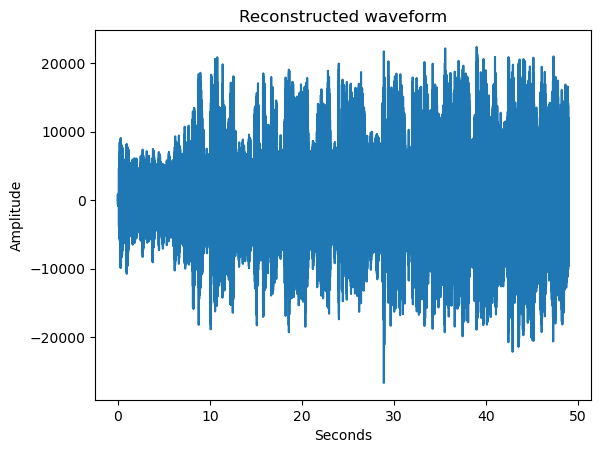

In [31]:
# Now can we play back the waveform?

#We must take the INVERSE Fourier Transform
RecoveredWaveform = np.fft.ifft(y_s)
plt.figure(6)
plt.plot(x/rate, RecoveredWaveform)
plt.title("Reconstructed waveform")
plt.ylabel("Amplitude")
plt.xlabel("Seconds")
ip.display.Audio(RecoveredWaveform, rate = rate)